In [1]:
#Import modules
#!pip install librosa
#!pip install pydub
import numpy as np
import IPython.display as ipd
import soundfile as sf
import os
from pathlib import Path
from math import ceil
from pydub import AudioSegment
from timeit import default_timer as timer
#from resemblyzer import preprocess_wav, VoiceEncoder
from pydub.silence import split_on_silence
import math
#import matplotlib
import matplotlib.pyplot as plt

In [2]:
import librosa
import librosa.display

In [3]:
import pandas as pd

# Load audio

## Convert mp3 to Wav

In [4]:
audiofile = "input/InterviewTwoP.mp3"
name = Path(audiofile).stem
namewav = os.path.join(name + '.wav')
data, samplerate = sf.read(audiofile)
sf.write("input/" + namewav, data, samplerate)
wavfile = os.path.join("input/" + namewav)

In [5]:
exportpath = "export/tmp/"

In [6]:
ipd.Audio(wavfile)

In [7]:
y, source_sample_rate = librosa.load(wavfile)
y,source_sample_rate

(array([-1.4097895e-07, -2.1915184e-08,  2.5212648e-07, ...,
         6.5192580e-09, -7.6834112e-09,  6.9849193e-09], dtype=float32),
 22050)

# Split Chunks

In [8]:
def chunks(file):
    exportpath = "export/tmp/"
    sound_file = AudioSegment.from_wav(file)
    audio_chunks = split_on_silence(sound_file, min_silence_len=45, silence_thresh=-40)
    for i, chunk in enumerate(audio_chunks):
         out_file = exportpath + "chunk{0}.wav".format(i)
         chunk.export(out_file, format="wav")

In [9]:
chunks(wavfile)

# def Extract features

In [10]:
def feature_exttraction(file,N_MFCC):
    #load file`
    x, sample_rate = librosa.load(file)
    #Extract features from file
    mfcc = np.mean(librosa.feature.mfcc(y=x, sr=sample_rate, n_mfcc=N_MFCC).T, axis=0)
    return mfcc

In [11]:
CH_MFCCS = dict()
for ch in os.listdir(exportpath):
    
    #rint(ch)
    file = exportpath + ch
    #print(ch)
    chmfcc = feature_exttraction(file,100)
    CH_MFCCS[ch] = chmfcc

C:\Users\MiGames\anaconda3\lib\site-packages\librosa\core\spectrum.py:256: UserWarning: n_fft=2048 is too large for input signal of length=1632
  warnings.warn(
C:\Users\MiGames\anaconda3\lib\site-packages\librosa\core\spectrum.py:256: UserWarning: n_fft=2048 is too large for input signal of length=1588
  warnings.warn(


In [12]:
#CH_MFCCS

In [13]:
df = pd.DataFrame(CH_MFCCS)
#df

In [14]:
df = df.reset_index(inplace=True)

In [15]:
my_array = np.array(list(CH_MFCCS.values()))

In [16]:
#my_array

In [17]:
df = pd.DataFrame(my_array, columns = [i for i in range(1,101)], index = CH_MFCCS.keys())
df.reset_index(inplace=True)
#df

In [18]:
df2 = df.drop(labels ='index',axis=1 )

In [19]:
df3 = np.array(df2)

In [20]:
df3

array([[-2.60051605e+02,  1.15167946e+02, -2.04015198e+01, ...,
         8.29123199e-01,  5.15973508e-01,  8.99389029e-01],
       [-2.19821716e+02,  1.01757584e+02, -2.67039356e+01, ...,
        -1.94148332e-01,  2.30391207e-03,  2.49960378e-01],
       [-2.49517868e+02,  1.15395393e+02, -2.36221676e+01, ...,
        -1.40275598e-01, -3.33141625e-01,  8.95785540e-02],
       ...,
       [-2.70260895e+02,  1.10030502e+02, -2.16381717e+00, ...,
         8.42478633e-01, -7.38232806e-02,  9.06642854e-01],
       [-2.68058899e+02,  7.68993454e+01, -1.84218750e+01, ...,
        -1.02557361e-01, -1.10283720e+00, -9.99748856e-02],
       [-2.84987976e+02,  1.08315948e+02, -3.31077156e+01, ...,
         2.30432197e-01,  1.46689996e-01,  3.88253450e-01]], dtype=float32)

In [21]:
from sklearn.cluster import KMeans

In [22]:
#df3.isnull().sum()

### KMeans(n_clusters=8, *, init='k-means++', n_init='warn', max_iter=300, tol=0.0001, verbose=0, random_state=None, copy_x=True, algorithm='lloyd')[source]


In [23]:
kmeans = KMeans(n_clusters = 2, max_iter=300) 

In [24]:
kmeans

KMeans(n_clusters=2)

In [25]:
label = kmeans.fit_predict(df3)

C:\Users\MiGames\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\MiGames\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


In [26]:
label

array([0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0,
       1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0])

In [27]:
#filter rows of original data
X = df3[label == 0]
X

array([[-2.60051605e+02,  1.15167946e+02, -2.04015198e+01, ...,
         8.29123199e-01,  5.15973508e-01,  8.99389029e-01],
       [-2.19821716e+02,  1.01757584e+02, -2.67039356e+01, ...,
        -1.94148332e-01,  2.30391207e-03,  2.49960378e-01],
       [-2.49517868e+02,  1.15395393e+02, -2.36221676e+01, ...,
        -1.40275598e-01, -3.33141625e-01,  8.95785540e-02],
       ...,
       [-2.70260895e+02,  1.10030502e+02, -2.16381717e+00, ...,
         8.42478633e-01, -7.38232806e-02,  9.06642854e-01],
       [-2.68058899e+02,  7.68993454e+01, -1.84218750e+01, ...,
        -1.02557361e-01, -1.10283720e+00, -9.99748856e-02],
       [-2.84987976e+02,  1.08315948e+02, -3.31077156e+01, ...,
         2.30432197e-01,  1.46689996e-01,  3.88253450e-01]], dtype=float32)

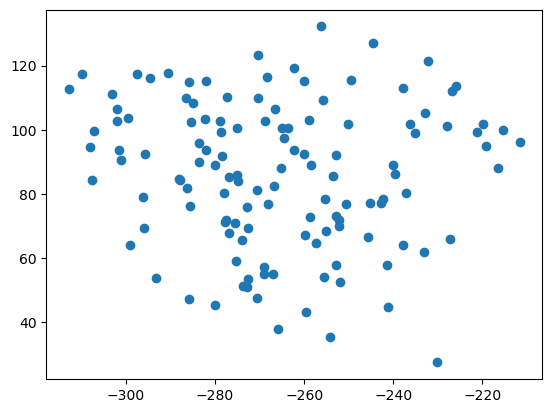

In [28]:
#plotting the results
plt.scatter(X[:,0] , X[:,1])
plt.show()

In [29]:
k=2

In [30]:
#Set rendom centroid
np.random.seed(0)
centroid_ids = np.random.choice(X.shape[0], k, replace=False)
centroid_ids

array([ 8, 50])

In [31]:
centroids = X[centroid_ids]
centroids

array([[-2.7685114e+02,  8.5431885e+01, -3.4015324e+01,  4.4727554e+01,
        -2.7552338e+00, -1.6473792e+00,  9.7932568e+00, -1.7593291e+00,
        -6.5103426e+00, -1.6067278e+01,  4.8446836e+00, -1.0574629e+01,
        -2.4408727e+00,  1.3759658e+01, -3.7727423e+00,  6.3732982e+00,
         2.2361476e+00,  3.8176901e+00,  2.5370362e+00,  6.2853327e+00,
        -4.0152389e-01, -6.3426800e-02, -2.2405946e+00, -9.3722355e-01,
        -2.4293635e+00,  1.9998713e+00, -3.4835720e+00,  3.4695497e+00,
        -2.0673544e+00,  2.2734048e+00, -1.9006628e-01,  3.8206806e+00,
        -1.4050463e+00,  3.0289657e+00, -2.5236795e+00,  7.2017622e-01,
        -1.5891211e+00, -3.1757471e-01,  1.8176483e+00,  2.4604855e+00,
        -2.6790452e+00,  2.1794410e+00, -1.6785856e+00,  3.1071794e+00,
        -3.6709645e-01,  1.4011183e+00,  1.3796960e-01, -2.9888067e-01,
        -1.2869173e+00,  4.0307045e+00, -2.4744456e+00,  3.5988873e-01,
        -1.2489017e+00,  1.0854028e+00, -1.6387875e+00,  2.93782

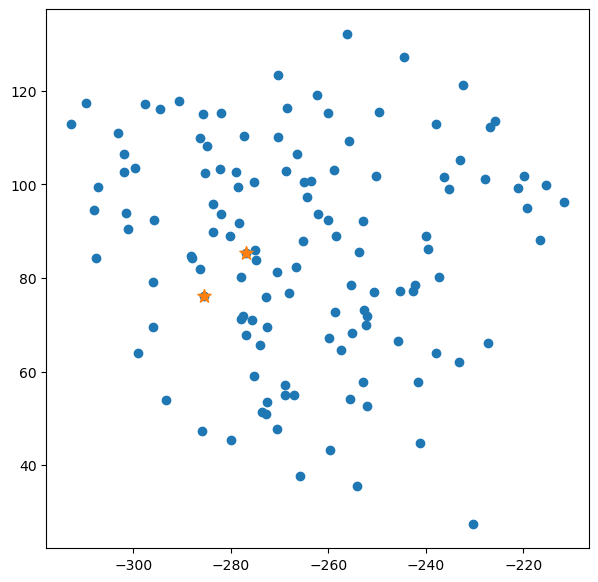

In [32]:
plt.figure(figsize=(7, 7))
plt.scatter(X[:, 0], X[:, 1])
plt.scatter(centroids[:, 0], centroids[:, 1], marker='*', s=100);

В качестве метрики расстояния будем использовать евклидово расстояние

$$\sqrt{\sum{(x_1 - x_2)^2}}$$

In [33]:
colors = ['green', 'red']

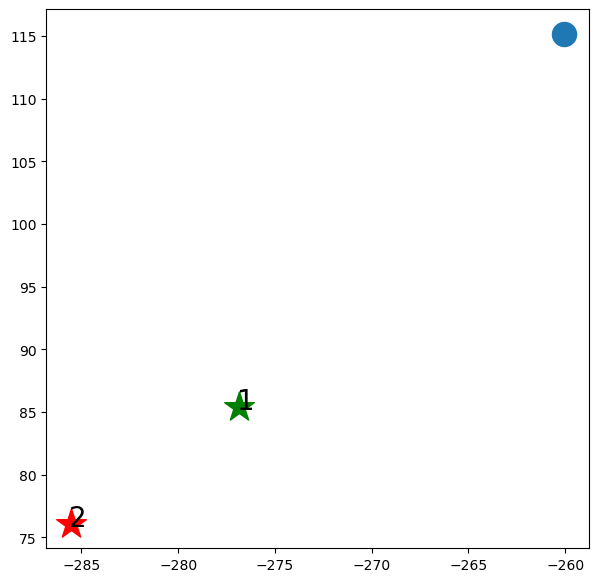

In [34]:
idx_1 = 0
plt.figure(figsize=(7, 7))
plt.scatter(X[idx_1, 0], X[idx_1, 1], s=300)

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [35]:
np.linalg.norm(centroids - X[idx_1], axis=1)

array([50.853104, 61.576504], dtype=float32)

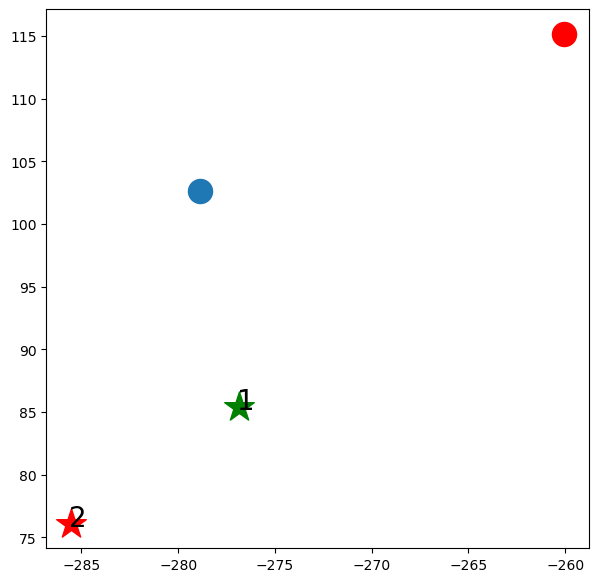

In [36]:
idx_2 = 11

plt.figure(figsize=(7, 7))
plt.scatter(X[idx_1, 0], X[idx_1, 1], s=300, c=colors[1])
plt.scatter(X[idx_2, 0], X[idx_2, 1], s=300)

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [37]:
np.linalg.norm(centroids - X[idx_2], axis=1)

array([44.5731  , 50.447456], dtype=float32)

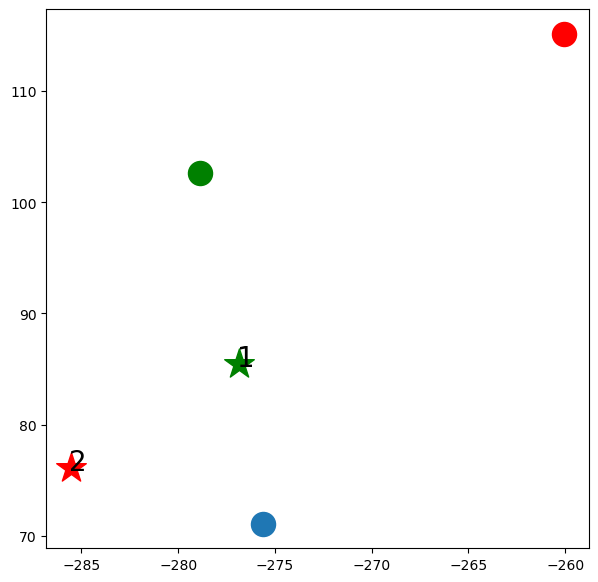

In [38]:
idx_3 = 9

plt.figure(figsize=(7, 7))
plt.scatter(X[idx_1, 0], X[idx_1, 1], s=300, c=colors[1])
plt.scatter(X[idx_2, 0], X[idx_2, 1], s=300, c=colors[0])
plt.scatter(X[idx_3, 0], X[idx_3, 1], s=300)

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [39]:
np.linalg.norm(centroids - X[idx_3], axis=1)

array([49.280178, 43.569397], dtype=float32)

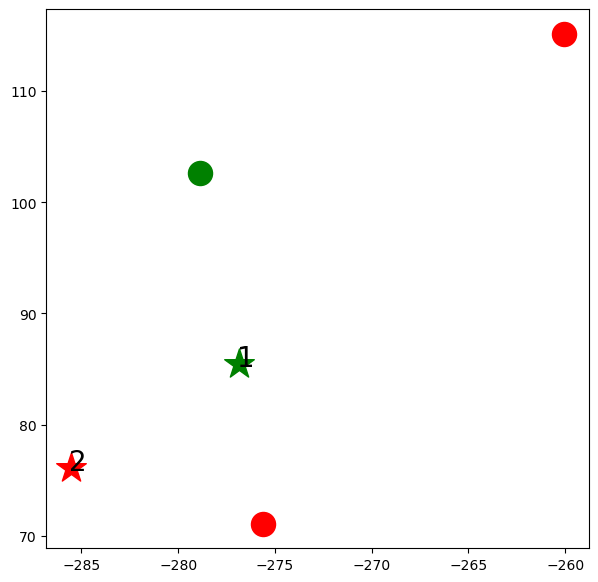

In [40]:
plt.figure(figsize=(7, 7))
plt.scatter(X[idx_1, 0], X[idx_1, 1], s=300, c=colors[1])
plt.scatter(X[idx_2, 0], X[idx_2, 1], s=300, c=colors[0])
plt.scatter(X[idx_3, 0], X[idx_3, 1], s=300, c=colors[1])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

Создадим словарь для кластеризации

In [41]:
clusters = {i: [] for i in range(k)}
clusters

{0: [], 1: []}

In [42]:
for x in X:
    distances = np.linalg.norm(centroids - x, axis=1)
    cluster_ind = distances.argmin()
    clusters[cluster_ind].append(x)    
    
clusters

{0: [array([-2.60051605e+02,  1.15167946e+02, -2.04015198e+01,  4.41396790e+01,
         -1.63226175e+00, -5.00911570e+00,  2.66287637e+00, -1.22986069e+01,
         -5.31645250e+00, -6.43677044e+00, -8.92687130e+00, -4.41400719e+00,
          1.64796400e+00,  2.83427334e+00, -6.16658211e+00,  9.19912910e+00,
         -7.41491675e-01, -6.93878078e+00,  7.05011725e-01,  1.02909005e+00,
         -1.02212372e+01, -1.98229730e-01, -6.79920197e+00, -1.16616809e+00,
          1.50888574e+00, -2.08248973e+00, -4.29761982e+00,  6.74369955e+00,
         -1.79377449e+00,  1.38766170e-02, -1.73930693e+00,  3.00004864e+00,
         -1.44309950e+00, -1.76824009e+00, -4.30010080e+00,  2.43912029e+00,
          9.67016816e-02, -6.63104832e-01, -1.42656851e+00,  1.57304466e+00,
         -1.49266338e+00,  1.33841288e+00, -2.78535008e+00,  5.70769072e-01,
         -2.83276463e+00,  5.37183166e-01, -3.25139689e+00, -1.04942358e+00,
         -3.69281435e+00,  1.12956154e+00, -9.82439756e-01,  3.41048622e+

In [43]:
len(clusters[0]), len(clusters[1])

(74, 52)

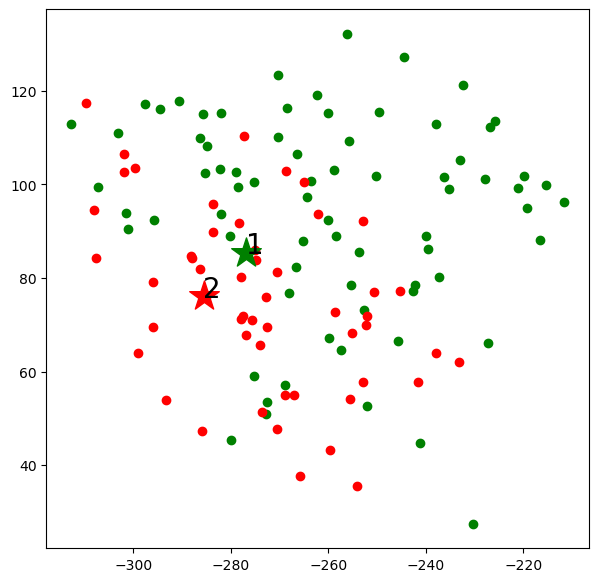

In [44]:
plt.figure(figsize=(7, 7))

for i in clusters:
    for x in clusters[i]:
        plt.scatter(x[0], x[1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [45]:
centroids

array([[-2.7685114e+02,  8.5431885e+01, -3.4015324e+01,  4.4727554e+01,
        -2.7552338e+00, -1.6473792e+00,  9.7932568e+00, -1.7593291e+00,
        -6.5103426e+00, -1.6067278e+01,  4.8446836e+00, -1.0574629e+01,
        -2.4408727e+00,  1.3759658e+01, -3.7727423e+00,  6.3732982e+00,
         2.2361476e+00,  3.8176901e+00,  2.5370362e+00,  6.2853327e+00,
        -4.0152389e-01, -6.3426800e-02, -2.2405946e+00, -9.3722355e-01,
        -2.4293635e+00,  1.9998713e+00, -3.4835720e+00,  3.4695497e+00,
        -2.0673544e+00,  2.2734048e+00, -1.9006628e-01,  3.8206806e+00,
        -1.4050463e+00,  3.0289657e+00, -2.5236795e+00,  7.2017622e-01,
        -1.5891211e+00, -3.1757471e-01,  1.8176483e+00,  2.4604855e+00,
        -2.6790452e+00,  2.1794410e+00, -1.6785856e+00,  3.1071794e+00,
        -3.6709645e-01,  1.4011183e+00,  1.3796960e-01, -2.9888067e-01,
        -1.2869173e+00,  4.0307045e+00, -2.4744456e+00,  3.5988873e-01,
        -1.2489017e+00,  1.0854028e+00, -1.6387875e+00,  2.93782

In [46]:
new_centroids = {}
for cluster in clusters:
    new_centroids[cluster] = np.mean(clusters[cluster], axis=0)

new_centroids

{0: array([-2.6009894e+02,  9.3694382e+01, -2.2964252e+01,  4.0093555e+01,
        -2.7334702e+00, -2.8712378e+00,  4.8774400e-01, -1.0758151e+01,
        -1.1986990e+01, -1.3064455e+01, -2.5071919e+00, -4.0107703e+00,
         1.4221377e+00,  3.5910954e+00, -8.3154182e+00,  9.1138096e+00,
        -4.1176638e-01, -6.9404757e-01,  3.0332801e+00,  4.3067150e+00,
        -4.7353873e+00,  1.5429176e+00, -1.9208797e+00,  8.8167645e-02,
        -1.8168914e+00,  1.4514493e+00, -2.2349975e+00,  3.3625271e+00,
        -1.5917802e+00,  2.5102253e+00, -4.8062938e-01,  2.4089475e+00,
        -1.3992537e+00,  2.6501846e+00, -1.8087655e+00,  1.3091326e+00,
        -2.0796819e+00,  2.0844619e-01, -1.6360748e+00,  6.9185567e-01,
        -1.9342375e+00,  1.8023250e+00, -1.7701397e+00,  2.3099375e+00,
        -9.7898465e-01,  1.1942981e+00, -6.4098650e-01,  1.5547098e+00,
        -1.0033774e+00,  2.1461022e+00, -1.0551479e+00,  2.0709875e+00,
        -5.7394993e-02,  1.5541911e+00,  3.4689093e-01,  2.79

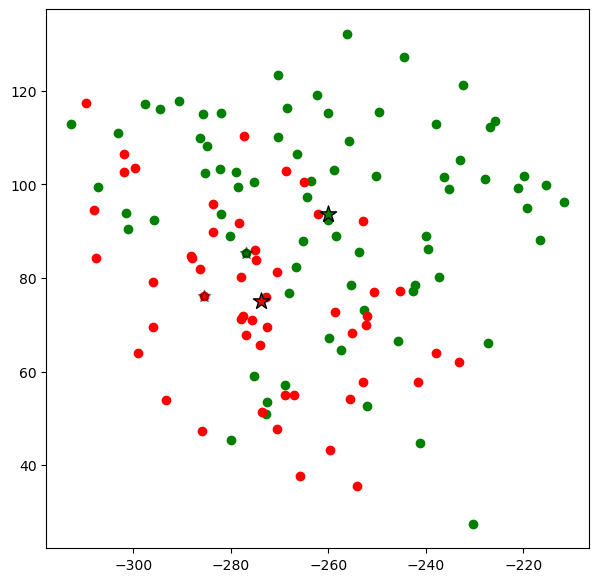

In [47]:
plt.figure(figsize=(7, 7))

for i in clusters:
    for x in clusters[i]:
        plt.scatter(x[0], x[1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], s=80, c=colors[i], marker='*', alpha=0.5, edgecolors='black')

for i in new_centroids:
    plt.scatter(new_centroids[i][0], new_centroids[i][1], marker='*', s=150, c=colors[i], edgecolors='black')

In [55]:
new_centroids = dict(sorted(new_centroids.items()))
new_centroids = np.array(list(new_centroids.values()))
centroids = new_centroids.copy()
centroids

array([[-2.6009894e+02,  9.3694382e+01, -2.2964252e+01,  4.0093555e+01,
        -2.7334702e+00, -2.8712378e+00,  4.8774400e-01, -1.0758151e+01,
        -1.1986990e+01, -1.3064455e+01, -2.5071919e+00, -4.0107703e+00,
         1.4221377e+00,  3.5910954e+00, -8.3154182e+00,  9.1138096e+00,
        -4.1176638e-01, -6.9404757e-01,  3.0332801e+00,  4.3067150e+00,
        -4.7353873e+00,  1.5429176e+00, -1.9208797e+00,  8.8167645e-02,
        -1.8168914e+00,  1.4514493e+00, -2.2349975e+00,  3.3625271e+00,
        -1.5917802e+00,  2.5102253e+00, -4.8062938e-01,  2.4089475e+00,
        -1.3992537e+00,  2.6501846e+00, -1.8087655e+00,  1.3091326e+00,
        -2.0796819e+00,  2.0844619e-01, -1.6360748e+00,  6.9185567e-01,
        -1.9342375e+00,  1.8023250e+00, -1.7701397e+00,  2.3099375e+00,
        -9.7898465e-01,  1.1942981e+00, -6.4098650e-01,  1.5547098e+00,
        -1.0033774e+00,  2.1461022e+00, -1.0551479e+00,  2.0709875e+00,
        -5.7394993e-02,  1.5541911e+00,  3.4689093e-01,  2.79329

In [56]:
clusters = {i: [] for i in range(k)}
clusters

{0: [], 1: []}

In [57]:
for x in X:
    distances = np.linalg.norm(centroids - x, axis=1)
    cluster_ind = distances.argmin()
    clusters[cluster_ind].append(x)    
    
clusters

{0: [array([-2.60051605e+02,  1.15167946e+02, -2.04015198e+01,  4.41396790e+01,
         -1.63226175e+00, -5.00911570e+00,  2.66287637e+00, -1.22986069e+01,
         -5.31645250e+00, -6.43677044e+00, -8.92687130e+00, -4.41400719e+00,
          1.64796400e+00,  2.83427334e+00, -6.16658211e+00,  9.19912910e+00,
         -7.41491675e-01, -6.93878078e+00,  7.05011725e-01,  1.02909005e+00,
         -1.02212372e+01, -1.98229730e-01, -6.79920197e+00, -1.16616809e+00,
          1.50888574e+00, -2.08248973e+00, -4.29761982e+00,  6.74369955e+00,
         -1.79377449e+00,  1.38766170e-02, -1.73930693e+00,  3.00004864e+00,
         -1.44309950e+00, -1.76824009e+00, -4.30010080e+00,  2.43912029e+00,
          9.67016816e-02, -6.63104832e-01, -1.42656851e+00,  1.57304466e+00,
         -1.49266338e+00,  1.33841288e+00, -2.78535008e+00,  5.70769072e-01,
         -2.83276463e+00,  5.37183166e-01, -3.25139689e+00, -1.04942358e+00,
         -3.69281435e+00,  1.12956154e+00, -9.82439756e-01,  3.41048622e+

In [59]:
len(clusters[0]), len(clusters[1])

(71, 55)

In [60]:
new_centroids = {}
for cluster in clusters:
    new_centroids[cluster] = np.mean(clusters[cluster], axis=0)

new_centroids

{0: array([-2.5919089e+02,  9.6227753e+01, -2.2408682e+01,  4.0210011e+01,
        -2.4506638e+00, -3.2523687e+00,  6.5477961e-01, -1.0894989e+01,
        -1.2463137e+01, -1.3244081e+01, -3.2580400e+00, -4.4818311e+00,
         1.5720135e+00,  3.3608768e+00, -9.1151686e+00,  8.9684973e+00,
        -6.0791802e-01, -9.0497333e-01,  3.1193955e+00,  4.2967677e+00,
        -4.7688947e+00,  1.3175592e+00, -1.9842002e+00, -4.3514293e-02,
        -1.8032721e+00,  1.5653411e+00, -2.5237870e+00,  3.3628190e+00,
        -1.6237806e+00,  2.5381067e+00, -5.4997092e-01,  2.4101188e+00,
        -1.3742133e+00,  2.7461095e+00, -1.7492834e+00,  1.4602498e+00,
        -1.9104794e+00,  1.0037860e-01, -1.6742599e+00,  6.9454688e-01,
        -1.9934864e+00,  1.8294903e+00, -1.7835397e+00,  2.1901064e+00,
        -9.6542811e-01,  1.2200692e+00, -7.2059333e-01,  1.3678814e+00,
        -1.1283563e+00,  2.0852447e+00, -1.0797651e+00,  2.0199308e+00,
        -1.7556699e-01,  1.4237977e+00,  1.2386118e-01,  2.58

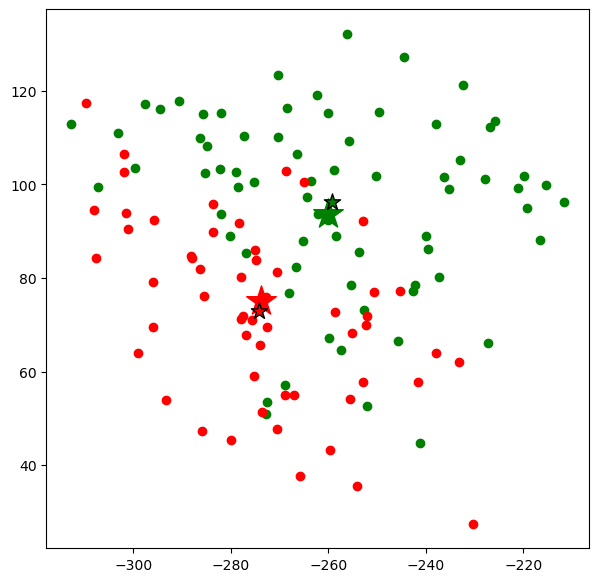

In [61]:
plt.figure(figsize=(7, 7))

for i in clusters:
    for x in clusters[i]:
        plt.scatter(x[0], x[1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])

for i in new_centroids:
    plt.scatter(new_centroids[i][0], new_centroids[i][1], marker='*', s=150, c=colors[i], edgecolors='black')

In [62]:
from tqdm import tqdm

def KMeans(X, k=2, num_iter=10):
    np.random.seed(0)
    centroid_ids = np.random.choice(X.shape[0], k, replace=False)
    centroids = X[centroid_ids]

    for i in tqdm(range(num_iter)):
        clusters = {i: [] for i in range(k)}

        for x in X:
            distances = np.linalg.norm(centroids - x, axis=1)
            cluster_ind = distances.argmin()
            clusters[cluster_ind].append(x)    
        
        new_centroids = {}
        for cluster in clusters:
            new_centroids[cluster] = np.mean(clusters[cluster], axis=0)

        new_centroids = dict(sorted(new_centroids.items()))
        new_centroids = np.array(list(new_centroids.values()))
        centroids = new_centroids.copy()

    return centroids, clusters

In [63]:
centroids, clusters = KMeans(X)
centroids

100%|██████████| 10/10 [00:00<00:00, 470.53it/s]


array([[-2.68179779e+02,  1.01840851e+02, -1.77125740e+01,
         4.28551140e+01,  1.89289880e+00, -3.80186152e+00,
        -6.90170705e-01, -9.34895706e+00, -1.32810974e+01,
        -1.42313194e+01, -4.32568789e+00, -6.36687660e+00,
         1.08388555e+00,  2.24028349e+00, -9.48712158e+00,
         8.42969799e+00, -1.35786605e+00, -1.80552840e+00,
         3.37301421e+00,  3.78178501e+00, -4.98861504e+00,
         1.02291727e+00, -2.01087856e+00, -5.83472699e-02,
        -2.17363906e+00,  1.59183145e+00, -2.12665224e+00,
         3.09254265e+00, -1.43360031e+00,  2.74066472e+00,
        -1.86160207e-01,  2.57185507e+00, -1.30027521e+00,
         2.82597613e+00, -1.71029568e+00,  1.44771385e+00,
        -1.77876639e+00,  4.34561729e-01, -1.44927847e+00,
         6.49607956e-01, -2.00635529e+00,  2.01106787e+00,
        -1.68127358e+00,  2.17235184e+00, -9.50893223e-01,
         1.03013873e+00, -8.42050374e-01,  1.17284703e+00,
        -1.57572007e+00,  1.45798469e+00, -1.59093535e+0

In [64]:
clusters

{0: [array([-2.60051605e+02,  1.15167946e+02, -2.04015198e+01,  4.41396790e+01,
         -1.63226175e+00, -5.00911570e+00,  2.66287637e+00, -1.22986069e+01,
         -5.31645250e+00, -6.43677044e+00, -8.92687130e+00, -4.41400719e+00,
          1.64796400e+00,  2.83427334e+00, -6.16658211e+00,  9.19912910e+00,
         -7.41491675e-01, -6.93878078e+00,  7.05011725e-01,  1.02909005e+00,
         -1.02212372e+01, -1.98229730e-01, -6.79920197e+00, -1.16616809e+00,
          1.50888574e+00, -2.08248973e+00, -4.29761982e+00,  6.74369955e+00,
         -1.79377449e+00,  1.38766170e-02, -1.73930693e+00,  3.00004864e+00,
         -1.44309950e+00, -1.76824009e+00, -4.30010080e+00,  2.43912029e+00,
          9.67016816e-02, -6.63104832e-01, -1.42656851e+00,  1.57304466e+00,
         -1.49266338e+00,  1.33841288e+00, -2.78535008e+00,  5.70769072e-01,
         -2.83276463e+00,  5.37183166e-01, -3.25139689e+00, -1.04942358e+00,
         -3.69281435e+00,  1.12956154e+00, -9.82439756e-01,  3.41048622e+

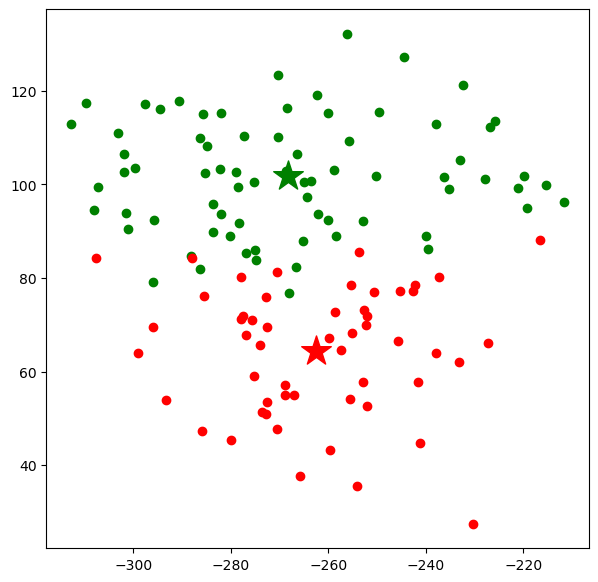

In [65]:
plt.figure(figsize=(7, 7))

for i in clusters:
    for x in clusters[i]:
        plt.scatter(x[0], x[1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])

In [66]:
def KMeans(X, k=3, num_iter=10, min_distance=1e-4, seed=0):
    np.random.seed(seed)
    centroid_ids = np.random.choice(X.shape[0], k, replace=False)
    centroids = X[centroid_ids]

    for i in range(num_iter):
        clusters = {i: [] for i in range(k)}

        for x in X:
            distances = np.linalg.norm(centroids - x, axis=1)
            cluster_ind = distances.argmin()
            clusters[cluster_ind].append(x)    
        
        new_centroids = {}
        for cluster in clusters:
            new_centroids[cluster] = np.mean(clusters[cluster], axis=0)

        new_centroids = dict(sorted(new_centroids.items()))
        new_centroids = np.array(list(new_centroids.values()))

        print(len(clusters[0]), len(clusters[1]), len(clusters[2]))
        print(new_centroids)

        is_stop = True
        for clust in range(len(centroids)):
            if np.linalg.norm(centroids[clust] - new_centroids[clust]) > min_distance:
                is_stop = False
                break
        if is_stop:
            print(f'stopping at iter {i}')
            break

        centroids = new_centroids.copy()

    return centroids, clusters

In [67]:
centroids, clusters = KMeans(X)
centroids

69 52 5
[[-2.6005051e+02  9.7061806e+01 -1.9717943e+01  4.0649582e+01
  -2.4074841e+00 -3.8307257e+00  1.6033389e-01 -1.0259325e+01
  -1.2073437e+01 -1.3730454e+01 -3.7282822e+00 -4.6780715e+00
   1.4260978e+00  3.2268238e+00 -8.7393007e+00  8.8083162e+00
  -7.2137439e-01 -7.6832432e-01  2.9658177e+00  4.1804428e+00
  -4.6990361e+00  1.3578994e+00 -1.9881983e+00 -1.1729518e-01
  -2.2727988e+00  1.5013486e+00 -2.3743658e+00  3.0261848e+00
  -1.6455564e+00  2.3912828e+00 -4.6907514e-01  2.6279922e+00
  -1.4502964e+00  2.7028990e+00 -1.6810462e+00  1.3653702e+00
  -2.0174117e+00  2.2317030e-01 -1.5888933e+00  6.2292898e-01
  -2.0969307e+00  1.8118281e+00 -1.8370141e+00  2.1469176e+00
  -1.0711979e+00  1.1102146e+00 -6.6689372e-01  1.4916592e+00
  -1.0650411e+00  2.0454056e+00 -1.1063225e+00  1.8912625e+00
  -2.0755716e-01  1.4693907e+00  2.2116525e-01  2.7455466e+00
  -1.5153174e-01  2.8558307e+00  4.3445316e-01  2.6728785e+00
   1.2210881e+00  2.4538717e+00  8.7869298e-01  2.8740001e+00


array([[-2.6001645e+02,  1.0092919e+02, -1.9951477e+01,  4.1347652e+01,
        -4.5704082e-01, -4.2451515e+00, -1.8789351e-01, -1.0620086e+01,
        -1.2762476e+01, -1.3596002e+01, -4.5118885e+00, -5.5165024e+00,
         1.4680521e+00,  2.8075264e+00, -9.6587992e+00,  8.9963560e+00,
        -1.1794609e+00, -1.2031802e+00,  2.9756744e+00,  4.0569296e+00,
        -4.7091084e+00,  1.2264297e+00, -2.1234946e+00, -2.7548751e-01,
        -2.0714595e+00,  1.4793203e+00, -2.5231714e+00,  3.2656407e+00,
        -1.6969585e+00,  2.4205279e+00, -4.0828243e-01,  2.4777126e+00,
        -1.3932173e+00,  2.7670753e+00, -1.7477583e+00,  1.4748396e+00,
        -1.7551764e+00,  1.9351228e-01, -1.6551648e+00,  6.1365825e-01,
        -2.1856058e+00,  1.7880408e+00, -1.8054730e+00,  2.0173862e+00,
        -1.1119815e+00,  1.0741125e+00, -7.8681982e-01,  1.2200128e+00,
        -1.2164577e+00,  1.9059689e+00, -1.1886926e+00,  1.8266131e+00,
        -3.2052228e-01,  1.3749146e+00,  2.9706815e-02,  2.45626

In [69]:
centr1 = np.array([[ 2.91329082,  5.33493484],
                   [ 2.89504171, -7.53408753],
                   [ 2.61305824,  3.369246  ]])
centr2 = np.array([[ 2.90614881,  5.43314686],
                   [ 2.89504171, -7.53408753],
                   [ 2.68953138,  3.53649614]])

IndexError: list index out of range

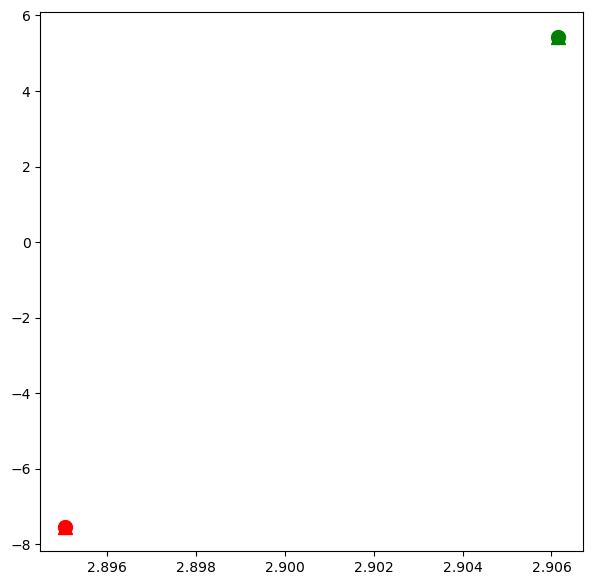

In [70]:
plt.figure(figsize=(7, 7))

for i, centr in enumerate(centr1):
    # plt.scatter(centr1[i][0], centr1[i][1], marker='*', s=100, c=colors[i])
    plt.scatter(centr2[i][0], centr2[i][1], marker='^', s=100, c=colors[i])
    plt.scatter(centr3[i][0], centr3[i][1], marker='o', s=100, c=colors[i])

In [73]:
np.linalg.norm(centr2[0] - centr3[0])

0.0

In [74]:
centroids, clusters = KMeans(X, seed=1)
centroids

43 37 46
[[-2.66560272e+02  6.39949989e+01 -2.88430767e+01  5.04911766e+01
   1.01135874e+01 -4.20385152e-01  4.99532729e-01 -1.37563438e+01
  -9.72271919e+00 -9.25857925e+00  1.67019159e-01 -3.86897111e+00
  -1.27921844e+00  3.41712666e+00 -7.79544640e+00  8.64297867e+00
  -4.99477297e-01 -1.28533036e-01  4.39544868e+00  4.45267773e+00
  -4.18345785e+00  2.13113523e+00 -2.16954660e+00  8.44865382e-01
  -1.09547400e+00  1.73154378e+00 -8.51558328e-01  3.72717953e+00
  -1.67628407e+00  3.24313951e+00 -1.11023378e+00  2.39723182e+00
  -1.66554916e+00  2.85653949e+00 -2.14393234e+00  1.86523116e+00
  -2.15823722e+00  6.91254959e-02 -1.16300917e+00  1.08157361e+00
  -1.39668143e+00  2.65664172e+00 -1.09741473e+00  3.00555944e+00
  -5.02963305e-01  1.45335376e+00 -5.30286074e-01  1.86454582e+00
  -1.09428632e+00  2.05851078e+00 -8.36127877e-01  2.38892770e+00
   3.85947376e-01  1.53457749e+00  3.02395850e-01  2.13138628e+00
  -4.71898735e-01  2.47993231e+00 -1.72906164e-02  2.76123500e+00
 

array([[-2.6421799e+02,  6.0604507e+01, -2.9159645e+01,  4.9636627e+01,
         1.1532004e+01, -8.1530124e-01, -1.3380226e-01, -1.2619519e+01,
        -1.1125193e+01, -1.0859573e+01,  3.0752847e-01, -5.2091045e+00,
        -1.4346061e+00,  3.4240081e+00, -8.9064932e+00,  9.3431387e+00,
         1.6389766e-01, -1.6909459e-01,  5.2583942e+00,  3.8953793e+00,
        -3.8274958e+00,  2.2778802e+00, -2.2946522e+00,  4.6423921e-01,
        -1.2799271e+00,  2.1230171e+00, -8.1657797e-01,  3.5090904e+00,
        -1.9725542e+00,  3.4819403e+00, -1.2104669e+00,  2.2956972e+00,
        -1.4055226e+00,  2.8484368e+00, -2.1919618e+00,  1.9292130e+00,
        -2.3184354e+00,  2.9670084e-01, -1.1267799e+00,  1.0110140e+00,
        -1.2807094e+00,  2.9212594e+00, -1.1068943e+00,  3.3718762e+00,
        -1.7544587e-01,  1.2687912e+00,  4.1599061e-02,  2.1140654e+00,
        -7.5733453e-01,  2.3392055e+00, -8.5683501e-01,  2.5466626e+00,
         3.7642080e-01,  1.6162512e+00,  6.0137343e-01,  2.45381

IndexError: list index out of range

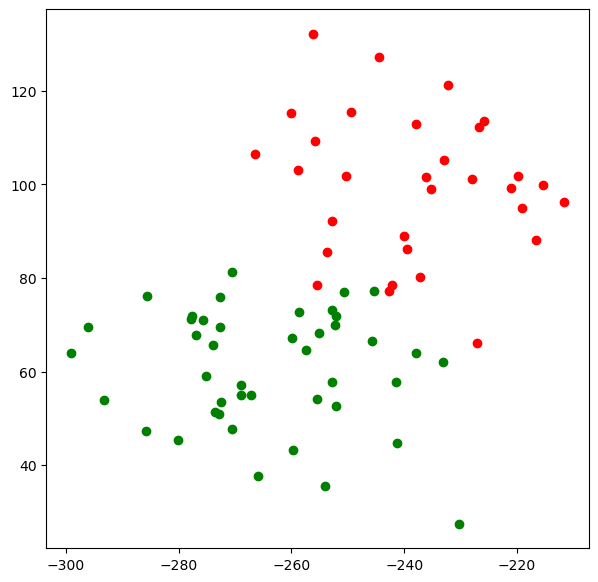

In [75]:
plt.figure(figsize=(7, 7))

for i in clusters:
    for x in clusters[i]:
        plt.scatter(x[0], x[1], color=colors[i])

for i, centr in enumerate(centroids):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [77]:
from sklearn.cluster import KMeans as sk_KMeans

model = sk_KMeans(n_clusters=2, 
                  init='k-means++',
                  max_iter=10,
                  random_state=0)

model.fit(X)

C:\Users\MiGames\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\MiGames\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


KMeans(max_iter=10, n_clusters=2, random_state=0)

In [78]:
labels = model.predict(X)
labels[:10]

array([0, 1, 0, 0, 0, 0, 0, 1, 0, 1])

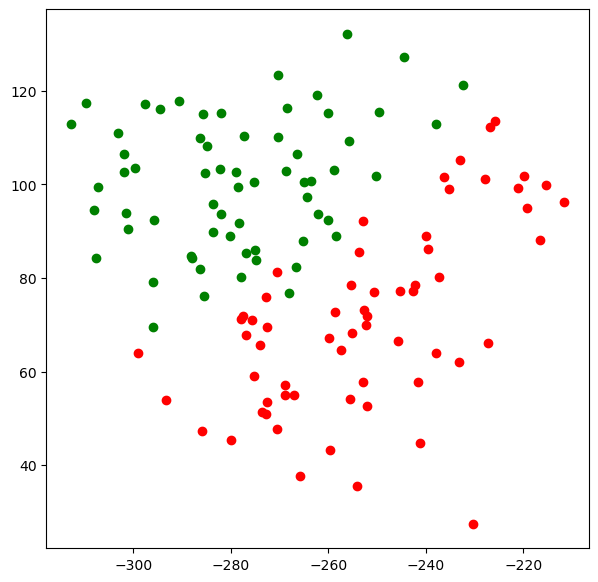

In [79]:
plt.figure(figsize=(7, 7))

for i in range(len(labels)):
    plt.scatter(X[i, 0], X[i, 1], color=colors[labels[i]])

In [80]:
model.cluster_centers_

array([[-2.7855905e+02,  1.0056709e+02, -1.6421206e+01,  4.2777248e+01,
         2.7754083e+00, -4.2482510e+00, -1.1603475e+00, -7.6470118e+00,
        -1.2560385e+01, -1.3571726e+01, -3.2596762e+00, -6.9261093e+00,
         1.3475057e+00,  2.7308598e+00, -1.0007724e+01,  7.7306995e+00,
        -9.2789835e-01, -1.8564625e+00,  3.8826435e+00,  3.7074473e+00,
        -4.4965754e+00,  8.5482806e-01, -1.9184065e+00,  1.8443322e-01,
        -2.1650310e+00,  2.0128248e+00, -1.7405398e+00,  3.2386661e+00,
        -1.2538567e+00,  3.0775993e+00, -8.3374381e-02,  2.7062514e+00,
        -1.1103042e+00,  2.8607435e+00, -1.5603989e+00,  1.7714431e+00,
        -1.8080015e+00,  5.1547629e-01, -1.1137899e+00,  8.5742921e-01,
        -1.6624557e+00,  2.3788600e+00, -1.5195341e+00,  2.4437778e+00,
        -7.1102583e-01,  9.4345975e-01, -5.4062259e-01,  1.1974726e+00,
        -1.4974755e+00,  1.7999619e+00, -1.6905607e+00,  1.5150888e+00,
        -6.2395489e-01,  1.1900300e+00, -5.6853116e-02,  2.03754

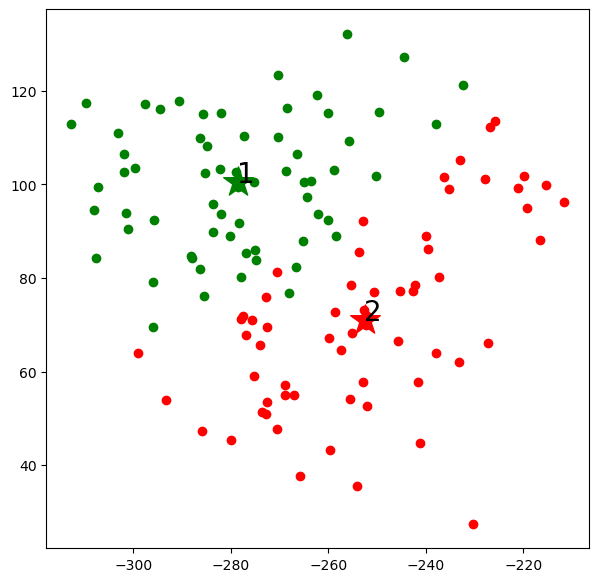

In [81]:
plt.figure(figsize=(7, 7))

for i in range(len(labels)):
    plt.scatter(X[i, 0], X[i, 1], color=colors[labels[i]])

for i, centr in enumerate(model.cluster_centers_):
    plt.scatter(centr[0], centr[1], marker='*', s=500, c=colors[i])
    plt.text(centr[0]-0.1, centr[1]-0.2, f'{i+1}', fontsize=20);

In [48]:
# plt.figure(figsize=(7, 7))
# plt.scatter(X[:, 0], X[:, 1]);

In [49]:
# from numpy import array, random

In [50]:
# import scipy
# from scipy.cluster.vq import vq, kmeans, whiten

In [51]:
# import matplotlib
# import matplotlib.pyplot as plt
# from matplotlib.pyplot import figure

In [52]:
# Создадим 50 наблюдений в кластерах a и b
# pts = 50
# a = np.random.multivariate_normal([0, 0], [[4, 1], [1, 4]], size = pts)
# b = np.random.multivariate_normal([30, 10],
#                                   [[10, 2], [2, 1]],
#                                   size = pts)
# features = np.concatenate((a, b))

In [53]:
# whitened = whiten(features)
# # Найдем два кластера в данных
# codebook, distortion = kmeans(whitened, 2)

In [54]:
# plt.scatter(whitened[:, 0], whitened[:, 1])
# plt.scatter(codebook[:, 0], codebook[:, 1], c = 'r')
# plt.show()